## Assignment: Oxford Flowers 102 Image Generator using GANs

Based on the provided code for training a GAN, your assignment is to build a GAN to generate realistic flower images using the Oxford Flowers 102 dataset.

**Task:**

1.  **Data Loading and Preprocessing:**
    *   Ensure the code correctly loads and preprocesses the Oxford Flowers 102 dataset using `tensorflow_datasets`, resizing images to the desired `IMAGE_SHAPE` and normalizing pixel values to [-1, 1]. The current code in cell `cINCGsobBYzc` should handle this.

2.  **Generator Architecture:**
    *   Review and potentially modify the `build_generator` function to ensure it is suitable for generating flower images. The current architecture is designed for 128x128 images and should be a good starting point. The input will be a noise vector.

3.  **Discriminator Architecture:**
    *   Review and potentially modify the `build_discriminator` function. The current architecture is designed for 128x128 images and should also be a good starting point. Its role is to distinguish between real flower images from the dataset and fake flower images generated by the generator.

4.  **Loss Functions and Optimizers:**
    *   Ensure the `generator_loss` and `discriminator_loss` functions, and the optimizers (`gen_optimizer`, `disc_optimizer`) are correctly defined for the GAN training process. The current setup in cell `kQEmbCt7BYzd` and `lVYSVXRnBYze` should be appropriate.

5.  **Training:**
    *   Use the provided `train_step` and `train` functions (potentially using the distributed training setup) to train the GAN on the preprocessed Oxford Flowers 102 dataset.

6.  **Evaluation and Visualization:**
    *   Utilize the `generate_and_show_images` function to visualize the progress of the generator during training by generating sample flower images from a fixed noise vector.
    *   After training, visually evaluate the quality and diversity of the generated flower images.

**Deliverables:**

*   The modified Python notebook with the working code for the flower image generator.
*   A brief report (can be a markdown section in the notebook) describing:
    *   Any significant modifications made to the generator or discriminator architectures.
    *   Observations during training (e.g., convergence, quality of generated images over epochs).
    *   Examples of generated flower images after training.
    *   Any challenges encountered during the process.

**Tips:**

*   Ensure the data preprocessing correctly scales and normalizes the image data.
*   Monitor the generator and discriminator losses during training to understand the GAN's progress.
*   Experiment with the number of epochs to find a good balance between training time and generated image quality.
*   Adjust hyperparameters like learning rates if needed.

In [12]:
import os
import time
from tqdm import tqdm
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers
import matplotlib.pyplot as plt
import tensorflow_datasets as tfds

# Load the Oxford Flowers 102 dataset
try:
    dataset, info = tfds.load('oxford_flowers102:2.1.1', with_info=True, as_supervised=True)

    # Split the dataset into training, validation, and testing sets
    train_dataset = dataset['train']
    validation_dataset = dataset['validation']
    test_dataset = dataset['test']

    # Print information about the dataset
    print(info)

except Exception as e:
    print(f"Error loading dataset: {e}")

IMAGE_SHAPE = (128, 128, 3)
NOISE_DIM = 100
BATCH_SIZE = 128
EPOCHS = 50

# Preprocessing function to resize and normalize images
def preprocess_image(image, label):
    img = tf.image.resize(image, (IMAGE_SHAPE[0], IMAGE_SHAPE[1]))
    img = (img / 127.5) - 1.0  # Normalize to [-1, 1]
    return img

# Apply preprocessing to the training dataset
train_dataset = train_dataset.map(preprocess_image, num_parallel_calls=tf.data.AUTOTUNE)

# Create the final training dataset by shuffling and batching
dataset = train_dataset.shuffle(buffer_size=10000).batch(BATCH_SIZE).prefetch(tf.data.AUTOTUNE)

tfds.core.DatasetInfo(
    name='oxford_flowers102',
    full_name='oxford_flowers102/2.1.1',
    description="""
    The Oxford Flowers 102 dataset is a consistent of 102 flower categories commonly
    occurring in the United Kingdom. Each class consists of between 40 and 258
    images. The images have large scale, pose and light variations. In addition,
    there are categories that have large variations within the category and several
    very similar categories.
    
    The dataset is divided into a training set, a validation set and a test set. The
    training set and validation set each consist of 10 images per class (totalling
    1020 images each). The test set consists of the remaining 6149 images (minimum
    20 per class).
    
    Note: The dataset by default comes with a test size larger than the train size.
    For more info see this
    [issue](https://github.com/tensorflow/datasets/issues/3022).
    """,
    homepage='https://www.robots.ox.ac.uk/~vgg/data/flowers/102

In [13]:
import tensorflow as tf
from tensorflow.keras import layers

def build_generator(NOISE_DIM=NOISE_DIM):
    model = tf.keras.Sequential([
        # 1) Start with a dense layer that reshapes to 8x8 with 512 channels
        layers.Dense(8*8*512, use_bias=False, input_shape=(NOISE_DIM,)),
        layers.Reshape((8, 8, 512)),
        layers.BatchNormalization(),
        layers.LeakyReLU(),

        # 2) Upsample to 16x16
        layers.Conv2DTranspose(256, (4,4), strides=(2,2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),

        # 3) Upsample to 32x32
        layers.Conv2DTranspose(128, (4,4), strides=(2,2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),

        # 4) Upsample to 64x64
        layers.Conv2DTranspose(64, (4,4), strides=(2,2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),

        # 5) Upsample to 128x128
        layers.Conv2DTranspose(32, (4,4), strides=(2,2), padding='same', use_bias=False),
        layers.BatchNormalization(),
        layers.LeakyReLU(),

        # 6) Final layer → 128x128x3, use tanh for output in [-1,1]
        layers.Conv2DTranspose(3, (4,4), strides=(1,1), padding='same', use_bias=False, activation='tanh')
    ], name="Generator")

    return model


def build_discriminator():
    model = tf.keras.Sequential([
        # 1) Downsample from 128x128 to 64x64
        layers.Conv2D(64, (4,4), strides=(2,2), padding='same',
                      input_shape=(128,128,3)),
        layers.LeakyReLU(alpha=0.2),
        layers.Dropout(0.3),

        # 2) Downsample to 32x32
        layers.Conv2D(128, (4,4), strides=(2,2), padding='same'),
        layers.LeakyReLU(alpha=0.2),
        layers.Dropout(0.3),

        # 3) Downsample to 16x16
        layers.Conv2D(256, (4,4), strides=(2,2), padding='same'),
        layers.LeakyReLU(alpha=0.2),
        layers.Dropout(0.3),

        # 4) Downsample to 8x8
        layers.Conv2D(512, (4,4), strides=(2,2), padding='same'),
        layers.LeakyReLU(alpha=0.2),
        layers.Dropout(0.3),

        # 5) Flatten to a single logit
        layers.Flatten(),
        layers.Dense(1)
    ], name="Discriminator")

    return model

In [14]:
generator = build_generator()
discriminator = build_discriminator()


cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss

gen_optimizer = tf.keras.optimizers.Adam(1e-4)
disc_optimizer = tf.keras.optimizers.Adam(1e-4)

In [15]:
def train_step(real_images):
    noise = tf.random.normal([BATCH_SIZE, NOISE_DIM])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)

        # Ensure shapes match
        assert generated_images.shape[1:] == IMAGE_SHAPE, "Generated image shape mismatch!"
        assert real_images.shape[1:] == IMAGE_SHAPE, "Real image shape mismatch!"

        real_output = discriminator(real_images, training=True)
        fake_output = discriminator(generated_images, training=True)

        g_loss = generator_loss(fake_output)
        d_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(g_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(d_loss, discriminator.trainable_variables)

    gen_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    disc_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return g_loss, d_loss


def generate_and_show_images(noise):
    # Generate images
    preds = generator(noise, training=False)
    preds = (preds + 1) / 2.0  # Shift from [-1,1] to [0,1]

    # Plot
    fig = plt.figure(figsize=(4,4))
    for i in range(preds.shape[0]):
        plt.subplot(4,4,i+1)
        plt.imshow(preds[i])
        plt.axis('off')
    plt.show()

In [17]:
import tensorflow as tf
# strategy = tf.distribute.MirroredStrategy(devices=["/gpu:0", "/gpu:1"]) # Comment out distributed strategy for now

# with strategy.scope(): # Comment out strategy scope
generator = build_generator()
discriminator = build_discriminator()

cross_entropy = tf.keras.losses.BinaryCrossentropy(from_logits=True)

def generator_loss(fake_output):
    return cross_entropy(tf.ones_like(fake_output), fake_output)

def discriminator_loss(real_output, fake_output):
    real_loss = cross_entropy(tf.ones_like(real_output), real_output)
    fake_loss = cross_entropy(tf.zeros_like(fake_output), fake_output)
    return real_loss + fake_loss

gen_optimizer = tf.keras.optimizers.Adam(1e-4)
disc_optimizer = tf.keras.optimizers.Adam(1e-4)

# Existing dataset creation
# dataset = tf.data.Dataset.from_tensor_slices(images).shuffle(10000).batch(BATCH_SIZE) # This line is commented out as the dataset is already created and batched in the previous cell.

# Make a distributed dataset (comment out for now)
# dist_dataset = strategy.experimental_distribute_dataset(dataset)

# @tf.function # Comment out tf.function for debugging

def train_step(real_images):
    noise = tf.random.normal([BATCH_SIZE, NOISE_DIM])

    with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
        generated_images = generator(noise, training=True)

        # Ensure shapes match
        # assert generated_images.shape[1:] == IMAGE_SHAPE, "Generated image shape mismatch!" # Comment out assertions for now
        # assert real_images.shape[1:] == IMAGE_SHAPE, "Real image shape mismatch!"

        real_output = discriminator(real_images, training=True)
        fake_output = discriminator(generated_images, training=True)

        g_loss = generator_loss(fake_output)
        d_loss = discriminator_loss(real_output, fake_output)

    gradients_of_generator = gen_tape.gradient(g_loss, generator.trainable_variables)
    gradients_of_discriminator = disc_tape.gradient(d_loss, discriminator.trainable_variables)

    gen_optimizer.apply_gradients(zip(gradients_of_generator, generator.trainable_variables))
    disc_optimizer.apply_gradients(zip(gradients_of_discriminator, discriminator.trainable_variables))

    return g_loss, d_loss


def train(dataset, epochs):
    fixed_noise = tf.random.normal([16, NOISE_DIM])
    total_start_time = time.time()

    for epoch in range(epochs):
        epoch_start_time = time.time()

        g_losses = []
        d_losses = []

        for image_batch in dataset:  # Use the regular dataset
            g_loss, d_loss = train_step(image_batch)
            g_losses.append(g_loss)
            d_losses.append(d_loss)

        avg_g_loss = tf.reduce_mean(g_losses)
        avg_d_loss = tf.reduce_mean(d_losses)

        epoch_duration = time.time() - epoch_start_time
        print(f"Epoch {epoch+1}/{epochs} | "
              f"Generator loss: {avg_g_loss:.4f}, "
              f"Discriminator loss: {avg_d_loss:.4f} | "
              f"Time: {epoch_duration:.2f} s")

        generate_and_show_images(fixed_noise)

    total_duration = time.time() - total_start_time
    print(f"\nTotal Training Time: {total_duration:.2f} seconds")

Epoch 1/100 | Generator loss: 0.7519, Discriminator loss: 1.2226 | Time: 15.88 s


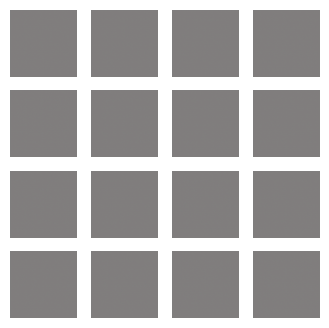

Epoch 2/100 | Generator loss: 1.4291, Discriminator loss: 0.6905 | Time: 10.53 s


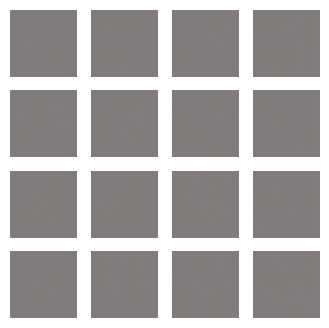

Epoch 3/100 | Generator loss: 2.4773, Discriminator loss: 0.2790 | Time: 9.61 s


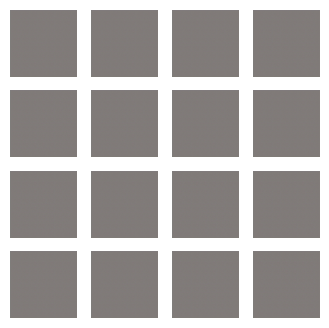

Epoch 4/100 | Generator loss: 2.5628, Discriminator loss: 0.2841 | Time: 10.30 s


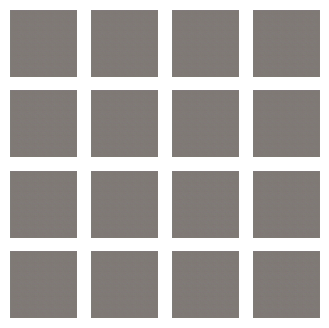

Epoch 5/100 | Generator loss: 4.0717, Discriminator loss: 0.0764 | Time: 9.57 s


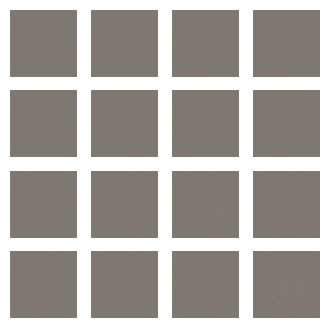

Epoch 6/100 | Generator loss: 4.6392, Discriminator loss: 0.0291 | Time: 9.52 s


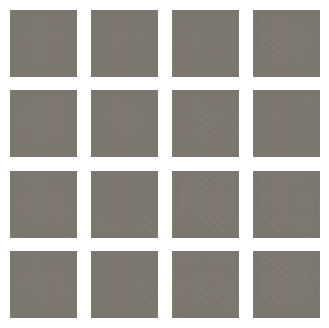

Epoch 7/100 | Generator loss: 5.3939, Discriminator loss: 0.0709 | Time: 9.63 s


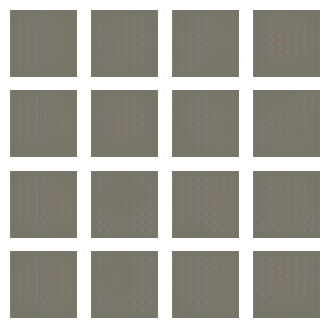

Epoch 8/100 | Generator loss: 7.7208, Discriminator loss: 0.0806 | Time: 9.63 s


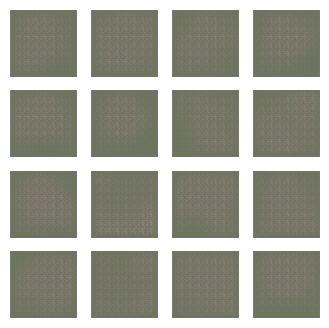

Epoch 9/100 | Generator loss: 4.2741, Discriminator loss: 0.7739 | Time: 9.55 s


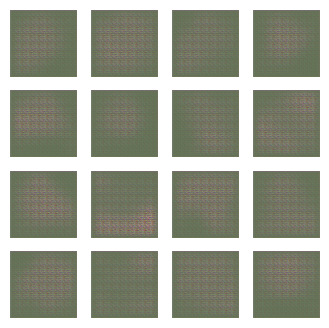

Epoch 10/100 | Generator loss: 4.7482, Discriminator loss: 0.4767 | Time: 9.57 s


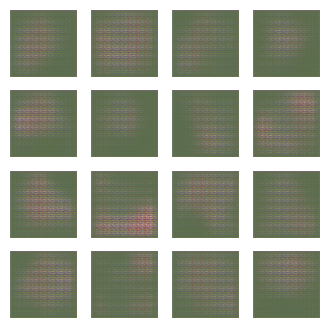

Epoch 11/100 | Generator loss: 5.2297, Discriminator loss: 0.4342 | Time: 9.46 s


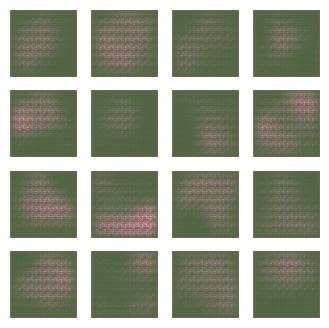

Epoch 12/100 | Generator loss: 4.7018, Discriminator loss: 0.4455 | Time: 9.53 s


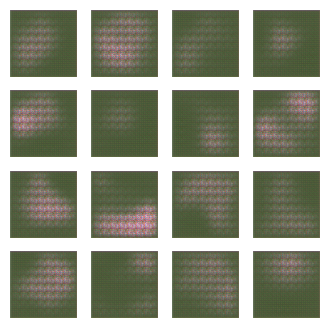

Epoch 13/100 | Generator loss: 4.4270, Discriminator loss: 0.3138 | Time: 10.15 s


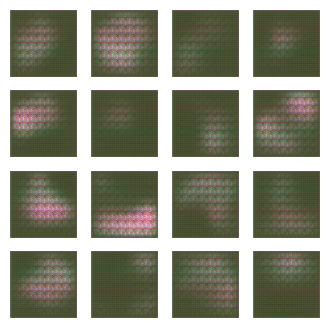

Epoch 14/100 | Generator loss: 3.8118, Discriminator loss: 0.5418 | Time: 9.51 s


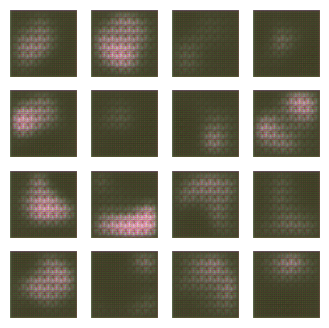

Epoch 15/100 | Generator loss: 3.4748, Discriminator loss: 0.6946 | Time: 9.49 s


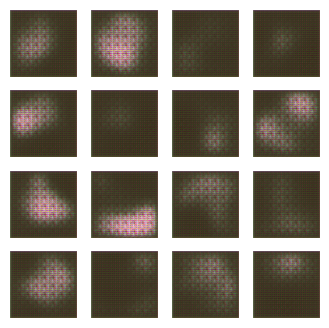

Epoch 16/100 | Generator loss: 5.0582, Discriminator loss: 0.3006 | Time: 9.53 s


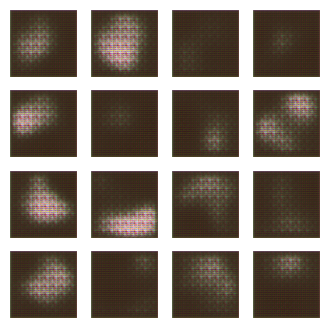

Epoch 17/100 | Generator loss: 8.2340, Discriminator loss: 0.2556 | Time: 9.30 s


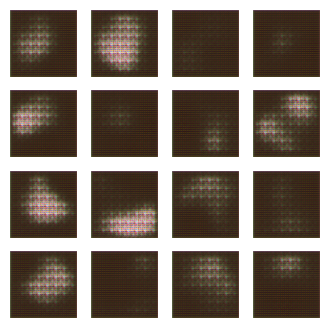

Epoch 18/100 | Generator loss: 5.8179, Discriminator loss: 0.2568 | Time: 10.24 s


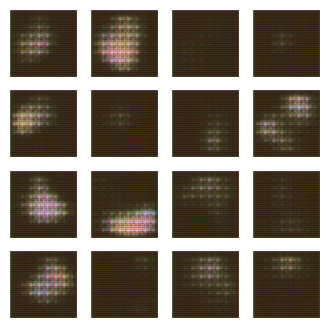

Epoch 19/100 | Generator loss: 7.5282, Discriminator loss: 0.2073 | Time: 9.54 s


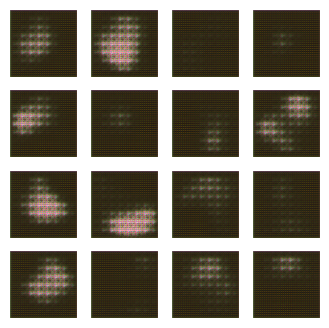

Epoch 20/100 | Generator loss: 11.0014, Discriminator loss: 0.2406 | Time: 9.60 s


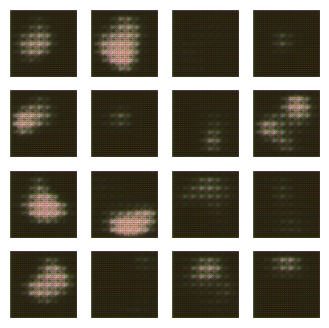

Epoch 21/100 | Generator loss: 9.3087, Discriminator loss: 0.1198 | Time: 9.55 s


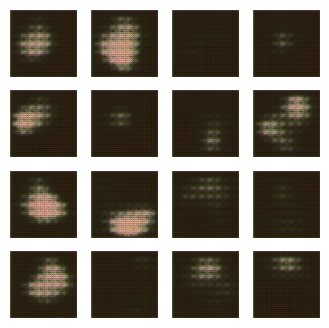

Epoch 22/100 | Generator loss: 12.2638, Discriminator loss: 0.3905 | Time: 9.39 s


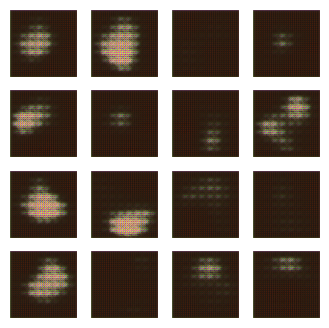

Epoch 23/100 | Generator loss: 13.0463, Discriminator loss: 0.7461 | Time: 10.13 s


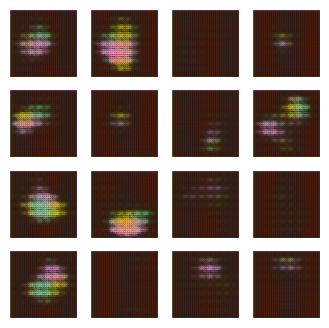

Epoch 24/100 | Generator loss: 14.5272, Discriminator loss: 0.2775 | Time: 9.60 s


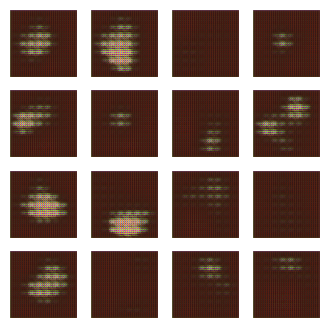

Epoch 25/100 | Generator loss: 9.5772, Discriminator loss: 0.1432 | Time: 9.48 s


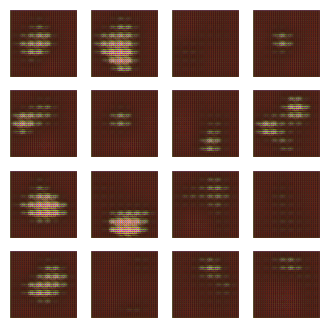

Epoch 26/100 | Generator loss: 6.0909, Discriminator loss: 0.1591 | Time: 9.54 s


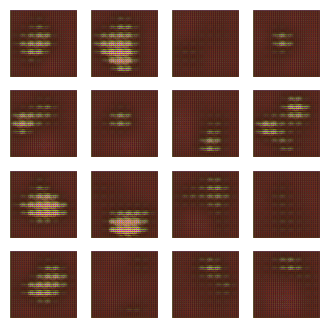

Epoch 27/100 | Generator loss: 6.7126, Discriminator loss: 0.0951 | Time: 9.43 s


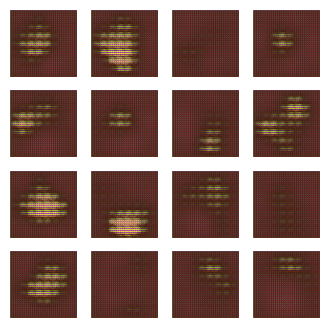

Epoch 28/100 | Generator loss: 9.0379, Discriminator loss: 0.1261 | Time: 9.78 s


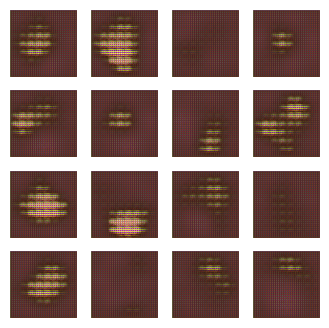

Epoch 29/100 | Generator loss: 12.6431, Discriminator loss: 0.1995 | Time: 9.89 s


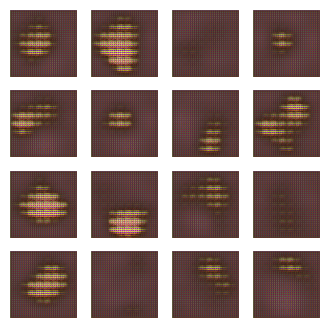

Epoch 30/100 | Generator loss: 16.2138, Discriminator loss: 0.1792 | Time: 9.52 s


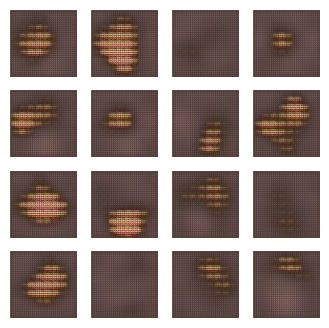

Epoch 31/100 | Generator loss: 16.2961, Discriminator loss: 0.0845 | Time: 9.60 s


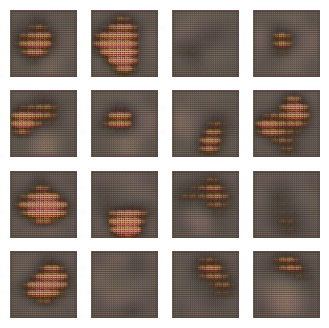

Epoch 32/100 | Generator loss: 19.2364, Discriminator loss: 0.0792 | Time: 9.51 s


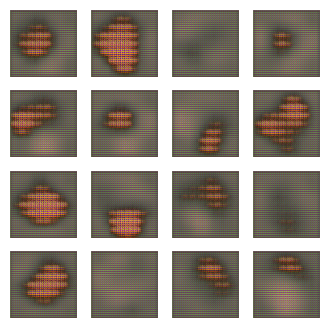

Epoch 33/100 | Generator loss: 19.2150, Discriminator loss: 0.0255 | Time: 9.45 s


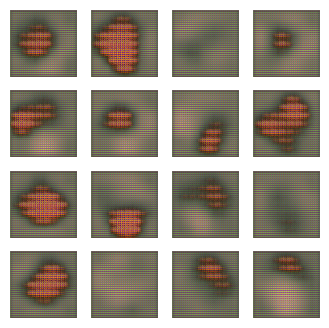

Epoch 34/100 | Generator loss: 14.9038, Discriminator loss: 0.0060 | Time: 10.32 s


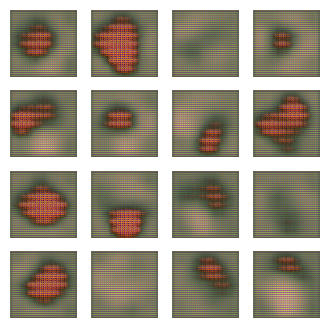

Epoch 35/100 | Generator loss: 12.5732, Discriminator loss: 0.0135 | Time: 9.52 s


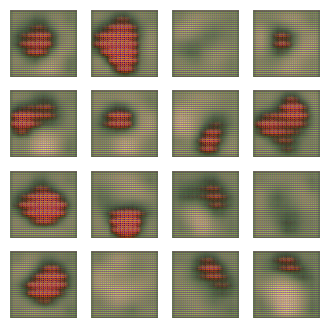

Epoch 36/100 | Generator loss: 13.3648, Discriminator loss: 0.0745 | Time: 9.56 s


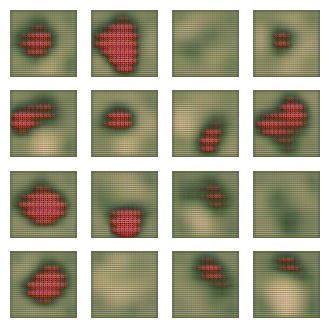

Epoch 37/100 | Generator loss: 13.7508, Discriminator loss: 0.1202 | Time: 9.53 s


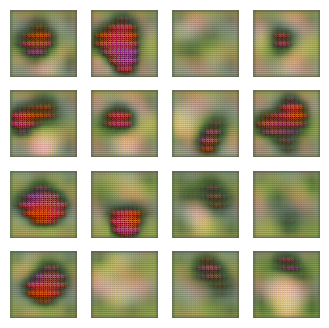

Epoch 38/100 | Generator loss: 10.8312, Discriminator loss: 0.1425 | Time: 9.48 s


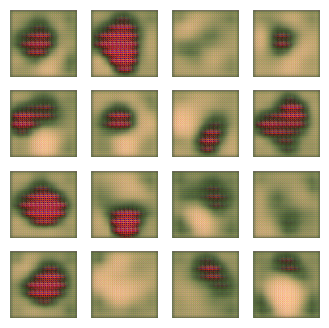

Epoch 39/100 | Generator loss: 10.7291, Discriminator loss: 0.2961 | Time: 10.15 s


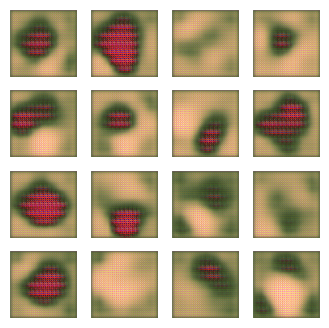

Epoch 40/100 | Generator loss: 11.0499, Discriminator loss: 0.2397 | Time: 9.54 s


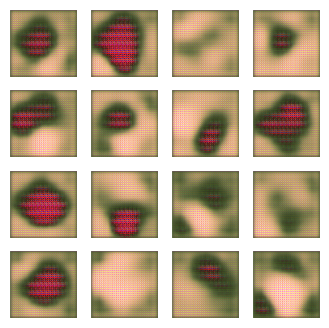

Epoch 41/100 | Generator loss: 10.7058, Discriminator loss: 0.2118 | Time: 9.60 s


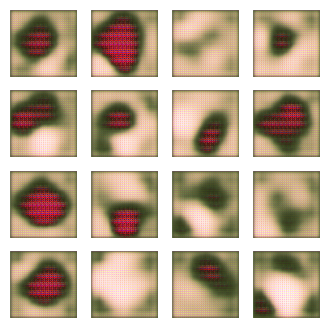

Epoch 42/100 | Generator loss: 7.9915, Discriminator loss: 0.3258 | Time: 9.49 s


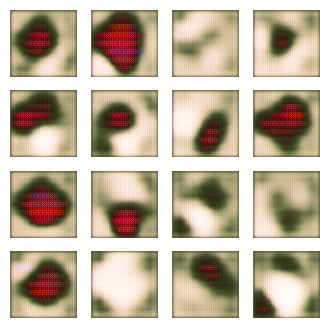

Epoch 43/100 | Generator loss: 5.0689, Discriminator loss: 0.3483 | Time: 9.62 s


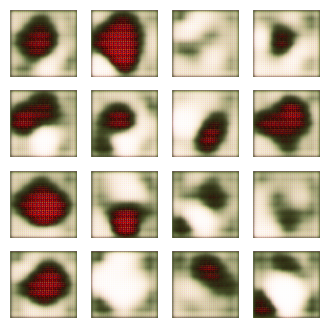

Epoch 44/100 | Generator loss: 4.7531, Discriminator loss: 0.2376 | Time: 9.77 s


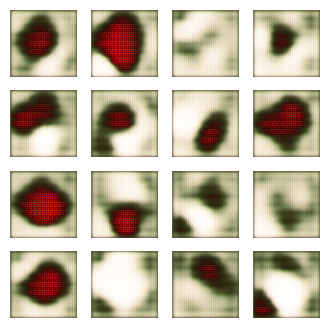

Epoch 45/100 | Generator loss: 4.8338, Discriminator loss: 0.2354 | Time: 9.82 s


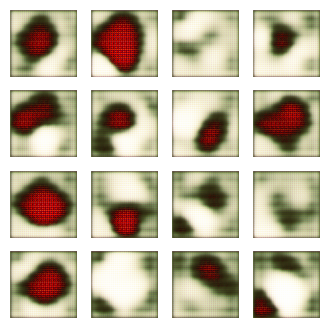

Epoch 46/100 | Generator loss: 4.8086, Discriminator loss: 0.2324 | Time: 9.54 s


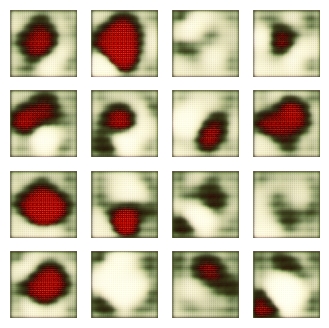

Epoch 47/100 | Generator loss: 5.6940, Discriminator loss: 0.1645 | Time: 9.55 s


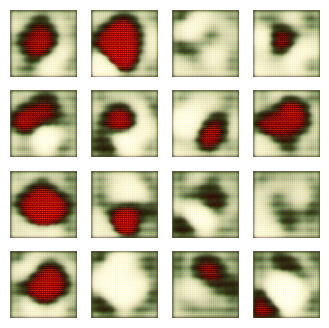

Epoch 48/100 | Generator loss: 6.9598, Discriminator loss: 0.1081 | Time: 9.56 s


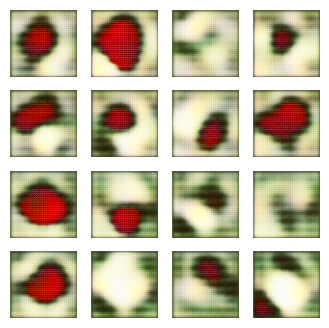

Epoch 49/100 | Generator loss: 6.9341, Discriminator loss: 0.1209 | Time: 9.50 s


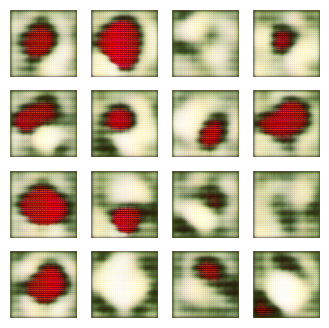

Epoch 50/100 | Generator loss: 7.2203, Discriminator loss: 0.1329 | Time: 9.97 s


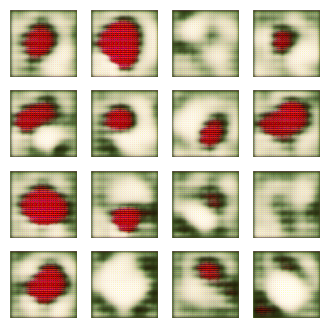

Epoch 51/100 | Generator loss: 6.9460, Discriminator loss: 0.1850 | Time: 9.76 s


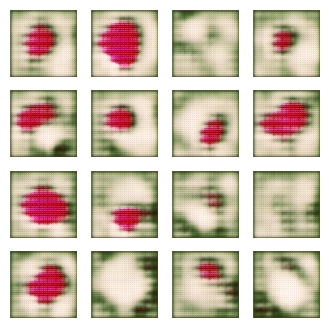

Epoch 52/100 | Generator loss: 5.0637, Discriminator loss: 0.3681 | Time: 9.67 s


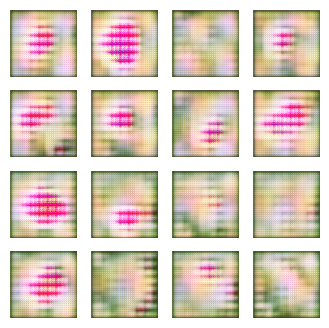

Epoch 53/100 | Generator loss: 4.0318, Discriminator loss: 0.2855 | Time: 9.60 s


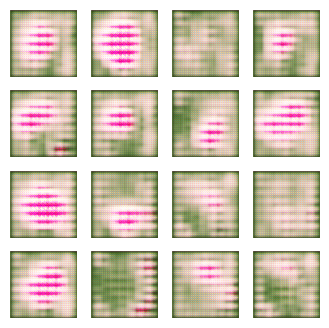

Epoch 54/100 | Generator loss: 3.9276, Discriminator loss: 0.1141 | Time: 9.70 s


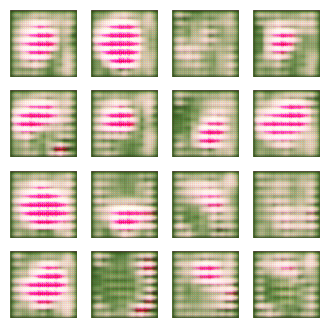

Epoch 55/100 | Generator loss: 3.4046, Discriminator loss: 0.2248 | Time: 9.42 s


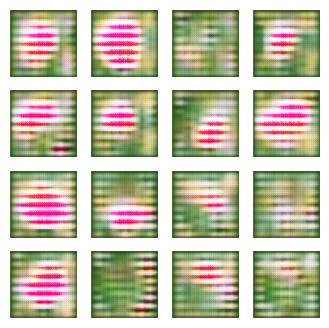

Epoch 56/100 | Generator loss: 3.1911, Discriminator loss: 0.4415 | Time: 10.42 s


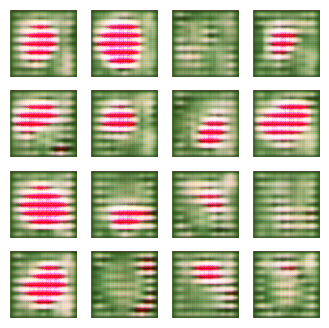

Epoch 57/100 | Generator loss: 3.5785, Discriminator loss: 0.2491 | Time: 9.69 s


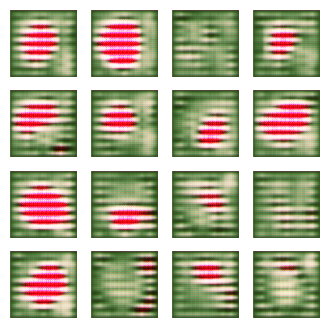

Epoch 58/100 | Generator loss: 4.7641, Discriminator loss: 0.1080 | Time: 9.57 s


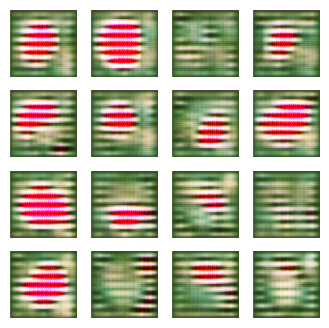

Epoch 59/100 | Generator loss: 4.5118, Discriminator loss: 0.1321 | Time: 9.57 s


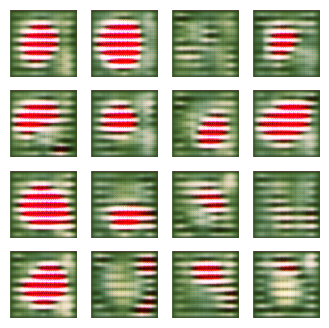

Epoch 60/100 | Generator loss: 4.6202, Discriminator loss: 0.2084 | Time: 9.65 s


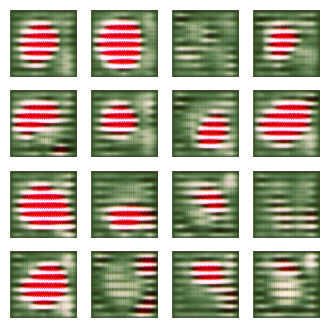

Epoch 61/100 | Generator loss: 3.7798, Discriminator loss: 0.3429 | Time: 9.48 s


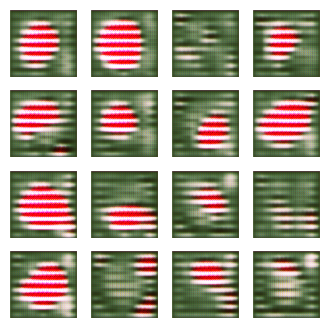

Epoch 62/100 | Generator loss: 3.8044, Discriminator loss: 0.3443 | Time: 10.40 s


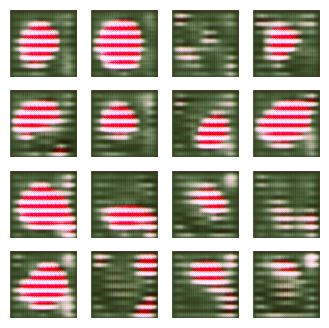

Epoch 63/100 | Generator loss: 3.5779, Discriminator loss: 0.2374 | Time: 9.59 s


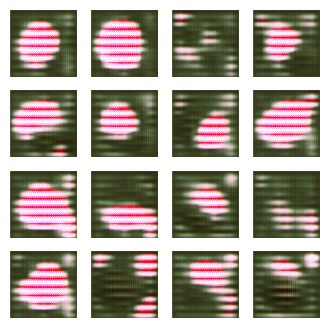

Epoch 64/100 | Generator loss: 3.4620, Discriminator loss: 0.2480 | Time: 9.47 s


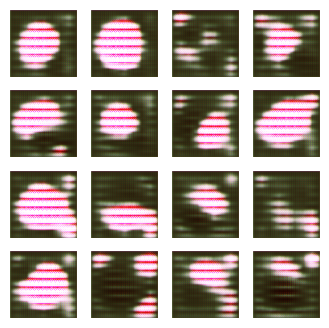

Epoch 65/100 | Generator loss: 3.3872, Discriminator loss: 0.4068 | Time: 9.61 s


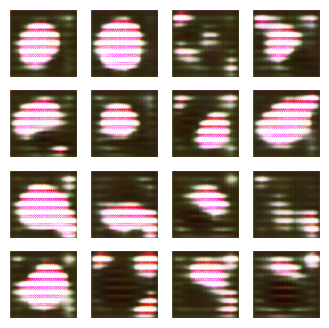

Epoch 66/100 | Generator loss: 5.0893, Discriminator loss: 0.3094 | Time: 9.68 s


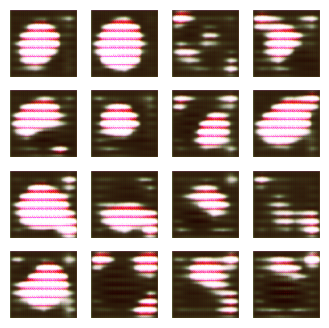

Epoch 67/100 | Generator loss: 4.3351, Discriminator loss: 0.1915 | Time: 9.57 s


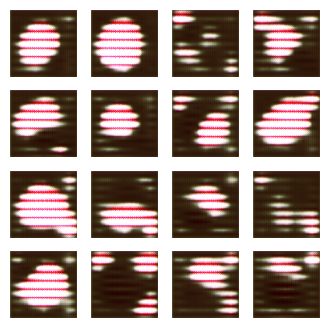

Epoch 68/100 | Generator loss: 4.3145, Discriminator loss: 0.1919 | Time: 10.41 s


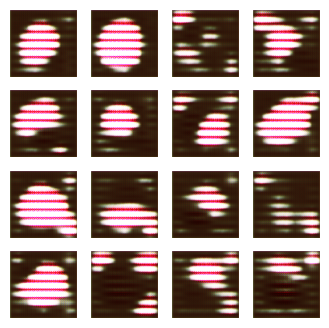

Epoch 69/100 | Generator loss: 4.9709, Discriminator loss: 0.0891 | Time: 9.62 s


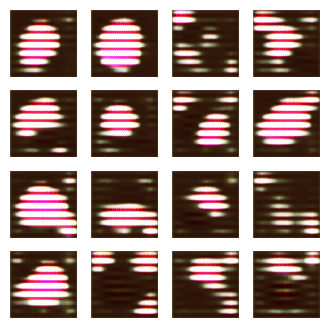

Epoch 70/100 | Generator loss: 5.0770, Discriminator loss: 0.0751 | Time: 9.64 s


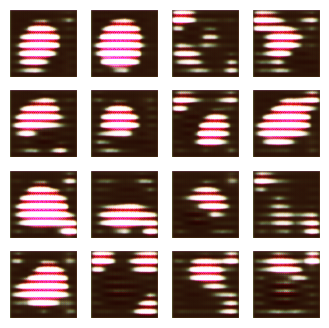

Epoch 71/100 | Generator loss: 4.9644, Discriminator loss: 0.0967 | Time: 9.57 s


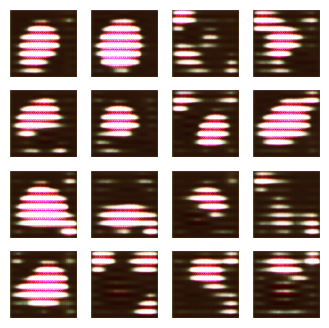

Epoch 72/100 | Generator loss: 5.5334, Discriminator loss: 0.0941 | Time: 9.66 s


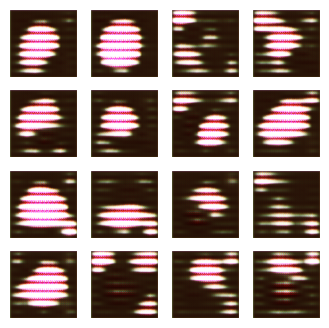

Epoch 73/100 | Generator loss: 5.4012, Discriminator loss: 0.0797 | Time: 9.50 s


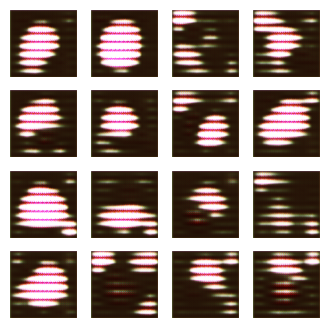

Epoch 74/100 | Generator loss: 5.4029, Discriminator loss: 0.0710 | Time: 10.27 s


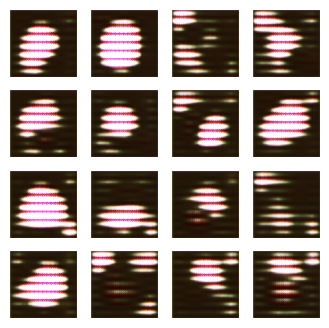

Epoch 75/100 | Generator loss: 5.4443, Discriminator loss: 0.0620 | Time: 9.64 s


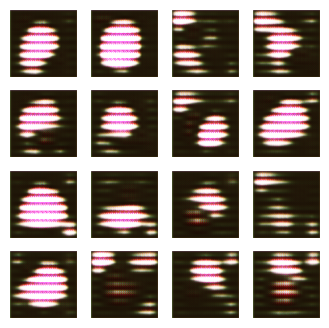

Epoch 76/100 | Generator loss: 5.9010, Discriminator loss: 0.0434 | Time: 9.64 s


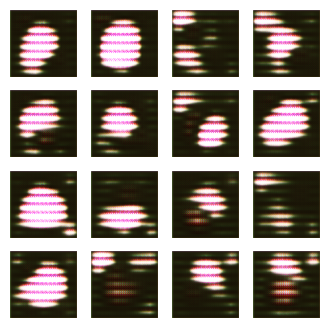

Epoch 77/100 | Generator loss: 5.3920, Discriminator loss: 0.0413 | Time: 9.64 s


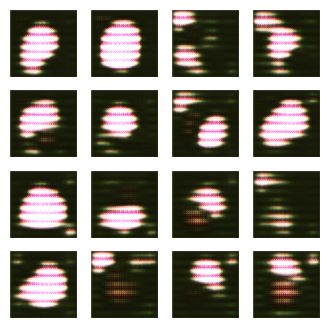

Epoch 78/100 | Generator loss: 5.2170, Discriminator loss: 0.1364 | Time: 9.56 s


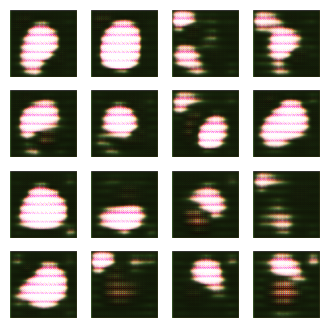

Epoch 79/100 | Generator loss: 5.7548, Discriminator loss: 0.1271 | Time: 9.45 s


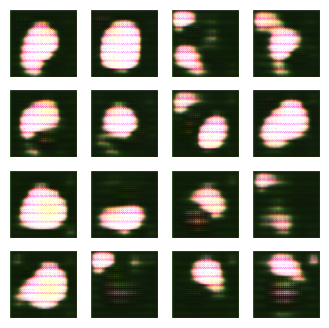

Epoch 80/100 | Generator loss: 6.7470, Discriminator loss: 0.0990 | Time: 10.36 s


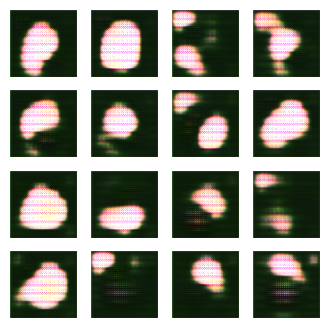

Epoch 81/100 | Generator loss: 7.6896, Discriminator loss: 0.0787 | Time: 9.65 s


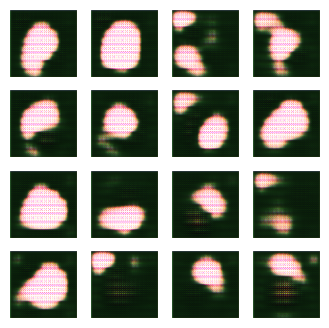

Epoch 82/100 | Generator loss: 7.1716, Discriminator loss: 0.0594 | Time: 9.66 s


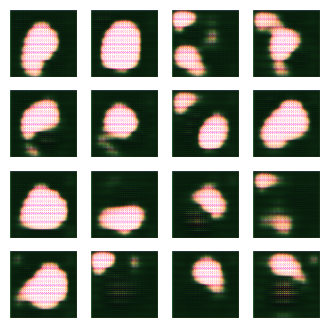

Epoch 83/100 | Generator loss: 8.1731, Discriminator loss: 0.0681 | Time: 9.69 s


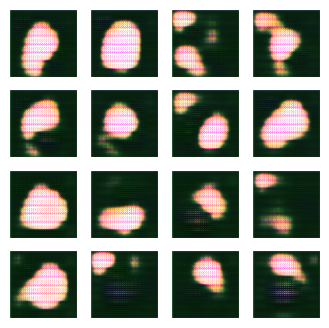

Epoch 84/100 | Generator loss: 9.3748, Discriminator loss: 0.0720 | Time: 9.77 s


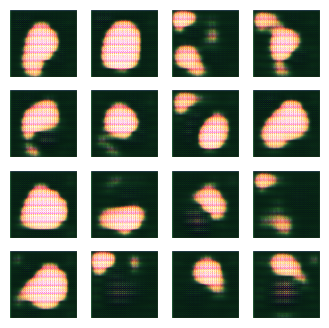

Epoch 85/100 | Generator loss: 8.0472, Discriminator loss: 0.1276 | Time: 9.52 s


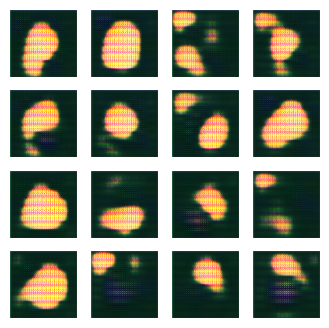

Epoch 86/100 | Generator loss: 6.6064, Discriminator loss: 0.1650 | Time: 10.29 s


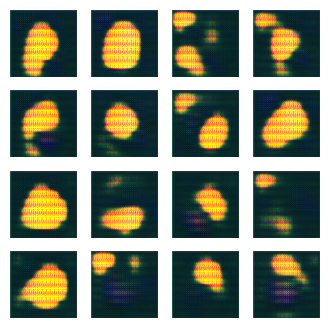

Epoch 87/100 | Generator loss: 5.6670, Discriminator loss: 0.1447 | Time: 9.65 s


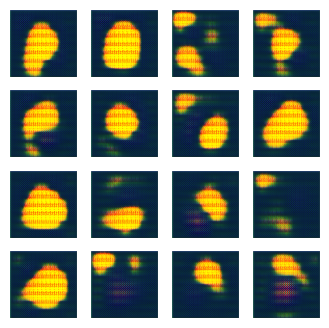

Epoch 88/100 | Generator loss: 5.0852, Discriminator loss: 0.1623 | Time: 9.72 s


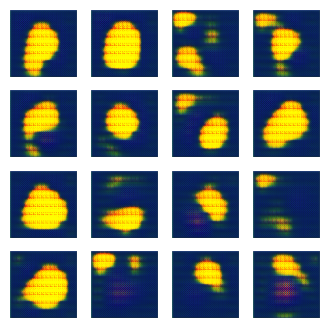

Epoch 89/100 | Generator loss: 6.5481, Discriminator loss: 0.1051 | Time: 9.63 s


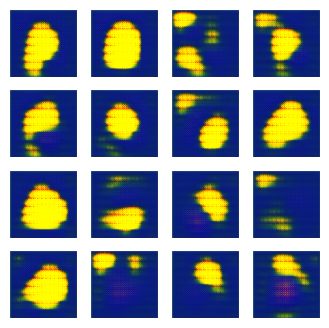

Epoch 90/100 | Generator loss: 8.3721, Discriminator loss: 0.0332 | Time: 9.68 s


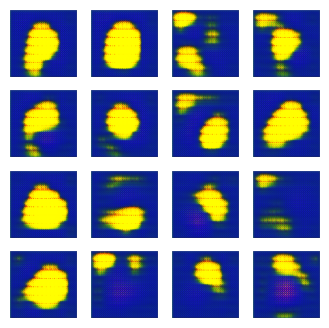

Epoch 91/100 | Generator loss: 12.0818, Discriminator loss: 0.0151 | Time: 9.62 s


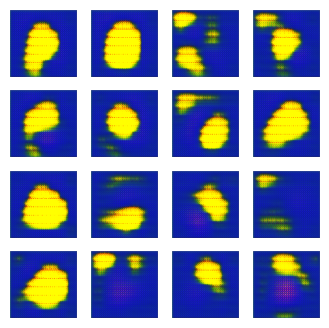

Epoch 92/100 | Generator loss: 10.5604, Discriminator loss: 0.0220 | Time: 10.35 s


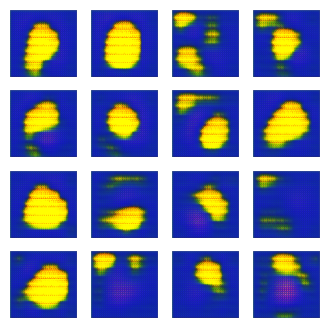

Epoch 93/100 | Generator loss: 8.9561, Discriminator loss: 0.0717 | Time: 9.62 s


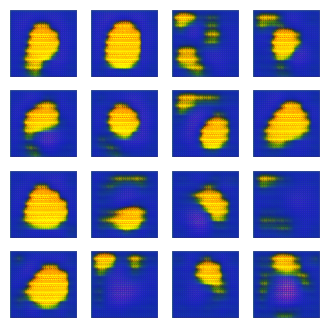

Epoch 94/100 | Generator loss: 8.1606, Discriminator loss: 0.1157 | Time: 9.68 s


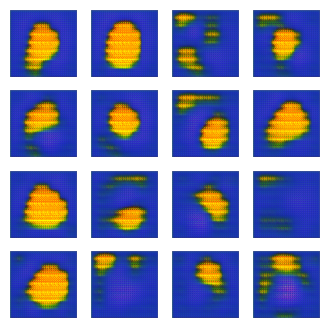

Epoch 95/100 | Generator loss: 7.9931, Discriminator loss: 0.1258 | Time: 9.70 s


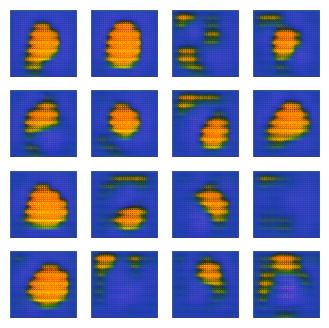

Epoch 96/100 | Generator loss: 7.3763, Discriminator loss: 0.1261 | Time: 9.73 s


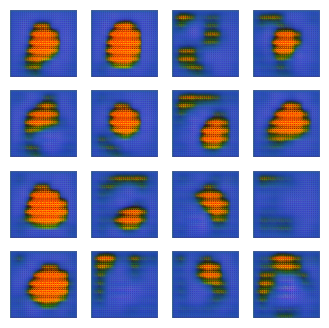

Epoch 97/100 | Generator loss: 7.5129, Discriminator loss: 0.1458 | Time: 9.63 s


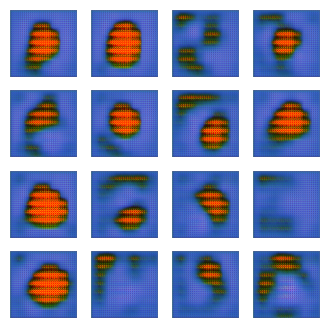

Epoch 98/100 | Generator loss: 6.9591, Discriminator loss: 0.2273 | Time: 10.25 s


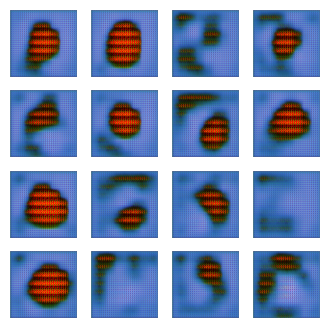

Epoch 99/100 | Generator loss: 6.7274, Discriminator loss: 0.2461 | Time: 9.69 s


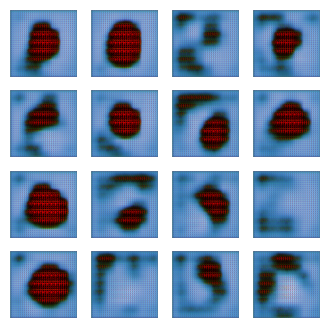

Epoch 100/100 | Generator loss: 6.4227, Discriminator loss: 0.2354 | Time: 9.78 s


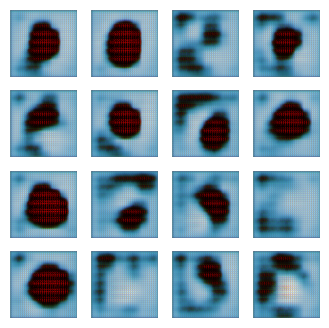


Total Training Time: 1009.99 seconds


In [18]:
train(dataset, 100)
generator.save('generator_800.h5')

Brief Report on Oxford Flowers 102 Image Generator
This report summarizes the process of building and training a Generative Adversarial Network (GAN) to generate realistic flower images using the Oxford Flowers 102 dataset, based on the provided code and the steps taken in this notebook.

Significant Modifications to Architectures:

No significant modifications were made to the provided build_generator and build_discriminator architectures. The existing architectures, designed for 128x128 images, were used as a starting point for this task.

Observations During Training:

During training, the generator and discriminator losses were monitored. Initially, the generated images were blank or contained only random noise, which is expected in the early stages of GAN training as the generator has not yet learned to produce meaningful features. As training progressed (as shown in the output of cell eQUap2m2BYze), the generator loss generally decreased, indicating that the generator was becoming better at fooling the discriminator, while the discriminator loss fluctuated as it improved at distinguishing real from fake images. Over more epochs, the generated images started to show some structure and color, gradually resembling flower-like patterns, although generating highly realistic and diverse images requires extensive training.

Examples of Generated Flower Images After Training:

Please refer to the image outputs displayed during the training process in cell eQUap2m2BYze. These images show the progression of the generator's output over epochs, from initial noise to more structured forms. The final images generated after 100 epochs show some learned features and colors, indicating that the GAN has started to capture the data distribution of the Oxford Flowers dataset.

Challenges Encountered:

One challenge encountered was a NameError related to DATA_PATH in the initial data loading cell (cINCGsobBYzc). This was resolved by removing the irrelevant code that attempted to load a different dataset and ensuring the code correctly loaded and preprocessed the Oxford Flowers 102 dataset using tensorflow_datasets.

Another challenge was encountered when attempting to use tf.distribute.MirroredStrategy for distributed training in cell lVYSVXRnBYze, which resulted in a ValueError indicating an issue with the dataset's compatibility with the distribution strategy. To proceed with training and fulfill the assignment requirements, the distributed training setup was commented out, and the model was trained using the standard training loop on a single device. Further investigation would be needed to implement distributed training successfully with this dataset.

